In [1]:
import numpy as np
import scipy as sp
from matplotlib import pyplot as plt
# from subset_select_entropic_FISTA_git import round_transpoly as round_transpoly
# from subset_select_entropic_FISTA_git import feasible_proj as feasible_proj
# from subset_select_entropic_FISTA_git import subset_select_FISTA as subset_select_FISTA
# from subset_select_entropic_FISTA_git import subset_select_FISTA as subset_select_FISTA2
# from subset_select_entropic_FISTA_git import subset_select_FISTA as subset_select_FISTA3
from subset_select_ipot_non_uniform_git import subset_select_ipot as ss_ipot
from subset_select_non_uniform_entropic_FISTA_git import subset_select_non_uniform_FISTA as ss

from tensorflow import keras as keras
from numpy.random import default_rng
import torch

if torch.cuda.is_available():
    device = torch.device("cuda:0")
else:
    device = "cpu"

from matplotlib.patches import Circle


# Data loading

In [2]:
(x_train, y_train), (x_test, y_test) = keras.datasets.cifar10.load_data()
y_train = np.squeeze(y_train)
y_test = np.squeeze(y_test)

# train = np.load('cifar10_train_resnet18.npz')
# test = np.load('cifar10_test_resnet18.npz')

# x_train_rep = train['x_train_rep']
# y_train = train['y_train_true']
# x_test_rep = test['x_test_rep']
# y_test = test['y_test_true']

x_train_rep = np.load("x_training_CIFAR_10_incpetion_resnet.npy")
x_test_rep = np.load("x_testing_CIFAR_10_incpetion_resnet.npy")

y_train_pred = np.load("y_train_pred_CIFAR10_inception_resnet.npy")
y_test_pred = np.load("y_test_pred_CIFAR10_inception_resnet.npy")


# Subset Selection Entropic

In [3]:
# m = 512
# n = 512

# ints1 = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
# # ints1 = [5]


# cs = [1, 1.25, 1.5, 1.75, 2, 4, 8, 16]


# def normalize(a): return a/np.sum(a)


# def distmat(X, Y):
#     D = np.sum(X**2, 1)[None, :] + np.sum(Y**2, 1)[:, None] - 2*Y@X.T
#     return D.T


# # ones_n = np.ones([n, 1])
# # ones_m = np.ones([m, 1])
# gamma = 0.005
# largest_k = 10
# smallest_k = 10
# Weights_top_10 = np.zeros([len(ints1), len(cs), largest_k])
# weights_bottom_10 = np.zeros([len(ints1), len(cs), largest_k])

# rng = np.random.default_rng(42)
# y_idx_list = list(rng.choice(
#     [r for r in range(0, len(y_test))], n,  replace=False))
# Y = x_test_rep[y_idx_list]
# label_Y = y_test[y_idx_list]

# y_idx_sorted_lst_c_int = {}
# y_nu_idx_sorted_lst_c_int = {}
# annot_y_sorted_lst_c_int = {}

# for i in range(0, len(ints1)):
#     int1 = ints1[i]
#     print(int1)

#     rng = np.random.default_rng(1)
#     annot_Y = torch.zeros_like(torch.from_numpy(y_test))
#     annot_Y[y_test == int1] = 1

#     rng = np.random.default_rng(1)
#     x_idx_list = list(rng.choice(np.squeeze(np.argwhere(y_train == int1)), m,))
#     X = x_train_rep[x_idx_list]
#     label_X = y_train[x_idx_list]

#     annot_X = torch.ones_like(torch.from_numpy(y_train))

#     mu = np.ones([m, 1])/m
#     nu = np.ones([n, 1])/n

#     M = np.linalg.norm(X[:, np.newaxis, :] - Y, axis=2, ord=1)
#     M = M/np.max(M)
#     K = np.exp(-M/(gamma))

#     fig, axs = plt.subplots(len(cs), largest_k, figsize=(12, 12))
#     fig.subplots_adjust(wspace=0, hspace=0.2)

#     fig1, axs1 = plt.subplots(len(cs), largest_k, figsize=(12, 12))
#     fig1.subplots_adjust(wspace=0, hspace=0.2)

#     y_idx_sorted_lst_c = []
#     nu_idx_sorted_lst_c = []
#     annot_Y_sorted_lst_c = []

#     for l in range(0, len(cs)):
#         c = cs[l]
#         print("c=",c)

#         P0, obj, alph, bet = ss(mu, nu, c, K,  M, gamma=gamma, Lt=1/gamma, max_iter=10000, back_tracking=False, disp_iter=False)

#         P = np.copy(P0)
#         nu_hat = np.sum(P, axis=0)
#         zipped_sorted_nu_idx = sorted(
#             zip(nu_hat, np.squeeze(y_idx_list)), reverse=True)
#         nu_sorted, idx_sorted = list(zip(*zipped_sorted_nu_idx))

#         y_idx_sorted_lst_c.append(list(idx_sorted))
#         nu_idx_sorted_lst_c.append(list(nu_sorted))
#         annot_Y_sorted = annot_Y[list(idx_sorted)]
#         annot_Y_sorted_lst_c.append(annot_Y_sorted)

#         nu_idx_sorted_10 = list(nu_sorted)[0:largest_k]
#         nu_idx_sorted_desc = list(nu_sorted)[-largest_k:]
#         annot_Y_sorted = annot_Y[list(idx_sorted)]

#         Z = x_test[list(idx_sorted)[0:largest_k]]
#         Z1 = x_test[list(idx_sorted)[-largest_k:]]

#         annot_Z = annot_Y_sorted[0:largest_k]
#         annot_Z1 = annot_Y_sorted[-largest_k:]

#         Weights_top_10[i, l, :] = np.array(nu_idx_sorted_10)
#         weights_bottom_10[i, l, :] = np.array(nu_idx_sorted_desc)

#         for k in range(0, Z.shape[0]):
#             if k == 0:
#                 axs[l, k].imshow(np.squeeze(Z[k]))
#                 axs[l, k].set_xticks([])
#                 axs[l, k].set_yticks([])
#                 ylabel_str = "c = {0}".format(c)
#                 axs[l, k].set_ylabel(ylabel_str, fontsize=16)

#                 axs1[l, k].imshow(np.squeeze(Z1[k]))
#                 axs1[l, k].set_xticks([])
#                 axs1[l, k].set_yticks([])
#                 ylabel_str = "c = {0}".format(c)
#                 axs1[l, k].set_ylabel(ylabel_str, fontsize=16)

#                 if annot_Z[k] == 0:
#                     circ = Circle((16, 16), 15,  alpha=1.0,
#                                   edgecolor="red",
#                                   facecolor="none",
#                                   joinstyle="miter",
#                                   linewidth=5,)
#                     axs[l, k].add_patch(circ)

#                 if annot_Z1[k] == 1:
#                     circ = Circle((16, 16), 15,  alpha=1.0,
#                                   edgecolor="blue",
#                                   facecolor="none",
#                                   joinstyle="miter",
#                                   linewidth=5,)
#                     axs1[l, k].add_patch(circ)
#             else:
#                 axs[l, k].imshow(np.squeeze(Z[k]))
#                 axs[l, k].set_xticks([])
#                 axs[l, k].set_yticks([])

#                 axs1[l, k].imshow(np.squeeze(Z1[k]))
#                 axs1[l, k].set_xticks([])
#                 axs1[l, k].set_yticks([])

#                 if annot_Z[k] == 0:
#                     circ = Circle((16, 16), 15,  alpha=1.0,
#                                   edgecolor="red",
#                                   facecolor="none",
#                                   joinstyle="miter",
#                                   linewidth=5,)
#                     axs[l, k].add_patch(circ)

#                 if annot_Z1[k] == 1:
#                     circ = Circle((16, 16), 15,  alpha=1.0,
#                                   edgecolor="blue",
#                                   facecolor="none",
#                                   joinstyle="miter",
#                                   linewidth=5,)
#                     axs1[l, k].add_patch(circ)

#     y_idx_sorted_lst_c_int[str(int1)] = y_idx_sorted_lst_c
#     y_nu_idx_sorted_lst_c_int[str(int1)] = nu_idx_sorted_lst_c
#     annot_y_sorted_lst_c_int[str(int1)] = annot_Y_sorted_lst_c
                    
    
#     y_idx_sorted_lst_c_int[str(int1)] = y_idx_sorted_lst_c
#     y_nu_idx_sorted_lst_c_int[str(int1)] = nu_idx_sorted_lst_c
#     annot_y_sorted_lst_c_int[str(int1)] = annot_Y_sorted_lst_c

#     file_name1 = "CIFAR_10" + "_f_SS_Fixed_Target_top="+str(int1)+".pdf"
#     file_name2 = "CIFAR_10" + "_f_SS_Fixed_Target_top="+str(int1)+".svg"
#     file_name3 = "CIFAR_10" + "_f_SS_Fixed_Target_top="+str(int1)+".png"

#     file_name4 = "CIFAR_10" + "_f_SS_Fixed_Target_bottom="+str(int1)+".pdf"
#     file_name5 = "CIFAR_10" + "_f_SS_Fixed_Target_bottom="+str(int1)+".svg"
#     file_name6 = "CIFAR_10" + "_f_SS_Fixed_Target_bottom="+str(int1)+".png"

#     fig.savefig(file_name1, dpi=500, bbox_inches='tight', format='pdf')
#     fig.savefig(file_name2, dpi=500, bbox_inches='tight', format='svg')
#     fig.savefig(file_name3, dpi=500, bbox_inches='tight', format='png')

#     fig1.savefig(file_name4, dpi=500, bbox_inches='tight', format='pdf')
#     fig1.savefig(file_name5, dpi=500, bbox_inches='tight', format='svg')
#     fig1.savefig(file_name6, dpi=500, bbox_inches='tight', format='png')


In [4]:
# from sklearn import metrics
# from sklearn.metrics import roc_curve
# from sklearn.metrics import roc_auc_score
# # from sklearn.metrics import RocCurveDisplay
# aucs_ints = {}

# for int in ints1:
#     fig, axs = plt.subplots()
#     aucs = []
#     y_idx_sorted_lst_c = y_idx_sorted_lst_c_int[str(int1)] 
#     nu_idx_sorted_lst_c = y_nu_idx_sorted_lst_c_int[str(int1)] 
#     annot_Y_sorted_lst_c = annot_y_sorted_lst_c_int[str(int1)]
#     for i in range(len(cs)):
#         sorted_idx_lst = y_idx_sorted_lst_c[i]
#         nu_sorted = np.array(nu_idx_sorted_lst_c[i])
#         annot_Y_sorted = np.array(annot_Y_sorted_lst_c[i])
#         fpr, tpr, _ = roc_curve(annot_Y_sorted, nu_sorted, pos_label=1)
#         aucs.append(roc_auc_score(annot_Y_sorted, nu_sorted))
#         axs.plot(fpr, tpr, linewidth=1, label=str(cs[i]))
    
#     aucs_ints[str(int)] = aucs
#     axs.set_title("Subset Selection")
#     axs.set_xlabel("FP")
#     axs.set_xlim([0, 1])
#     axs.set_ylim([0, 1])
#     axs.set_yticks([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0])
#     axs.grid(True)
#     axs.set_ylabel("TP")
#     axs.legend()
    
#     file_name1 = "CIFAR_10" + "SS_ROC_"+str(int1)+".pdf"
#     file_name2 = "CIFAR_10" + "SS_ROC_"+str(int1)+".svg"
#     file_name3 = "CIFAR_10" + "SS_ROC_"+str(int1)+".png"
    
#     fig.savefig(file_name1, dpi=500, bbox_inches='tight', format='pdf')
#     fig.savefig(file_name2, dpi=500, bbox_inches='tight', format='svg')
#     fig.savefig(file_name3, dpi=500, bbox_inches='tight', format='png')


# fig1, axs1 = plt.subplots()
# for int in ints1:
#     axs1.plot(cs, aucs_ints[str(int)], linestyle='dashdot', marker="s")
# axs1.set_xlabel("$c$")
# axs1.set_ylabel("AUC")


# file_name4 = "CIFAR_10" + "SS_AUC_c"+".pdf"
# file_name5 = "CIFAR_10" + "SS_AUC_c"+".svg"
# file_name6 = "CIFAR_10" + "SS_AUC_c"+".png"
# fig1.savefig(file_name4, dpi=500, bbox_inches='tight', format='pdf')
# fig1.savefig(file_name5, dpi=500, bbox_inches='tight', format='svg')
# fig1.savefig(file_name6, dpi=500, bbox_inches='tight', format='png')


# IPOT

0
c= 1
sum(P)= 0.9999877192147955
c= 1.25
sum(P)= 1.000016381423805
c= 1.5
sum(P)= 0.9999720763200924
c= 1.75
sum(P)= 1.000018308494336
c= 2
sum(P)= 0.9999622495909463
c= 4
sum(P)= 0.9999990987872254
c= 8
sum(P)= 0.9999961738529273
c= 16
sum(P)= 0.9999994516897686
c= 20
sum(P)= 1.00000006285352
c= 24
sum(P)= 1.0000000247403233
c= 28
sum(P)= 1.0000000107470728
c= 32
sum(P)= 1.0
1
c= 1
sum(P)= 0.9999858950498375
c= 1.25
sum(P)= 1.0000335916975793
c= 1.5
sum(P)= 0.9999633670942005
c= 1.75
sum(P)= 1.0000283798267318
c= 2
sum(P)= 0.999966862115932
c= 4
sum(P)= 1.000040979516089
c= 8
sum(P)= 1.0000272932104972
c= 16
sum(P)= 1.0000001349386725
c= 20
sum(P)= 1.0000000907677251
c= 24
sum(P)= 1.0000000573928993
c= 28
sum(P)= 1.0
c= 32
sum(P)= 1.0
2
c= 1
sum(P)= 0.9999931505674313
c= 1.25
sum(P)= 1.0000146004657338
c= 1.5
sum(P)= 0.9999644049593814
c= 1.75
sum(P)= 1.000025360417121
c= 2
sum(P)= 0.999990106073865
c= 4
sum(P)= 0.9999748185900134
c= 8
sum(P)= 0.9999873049415895
c= 16
sum(P)= 1.00000

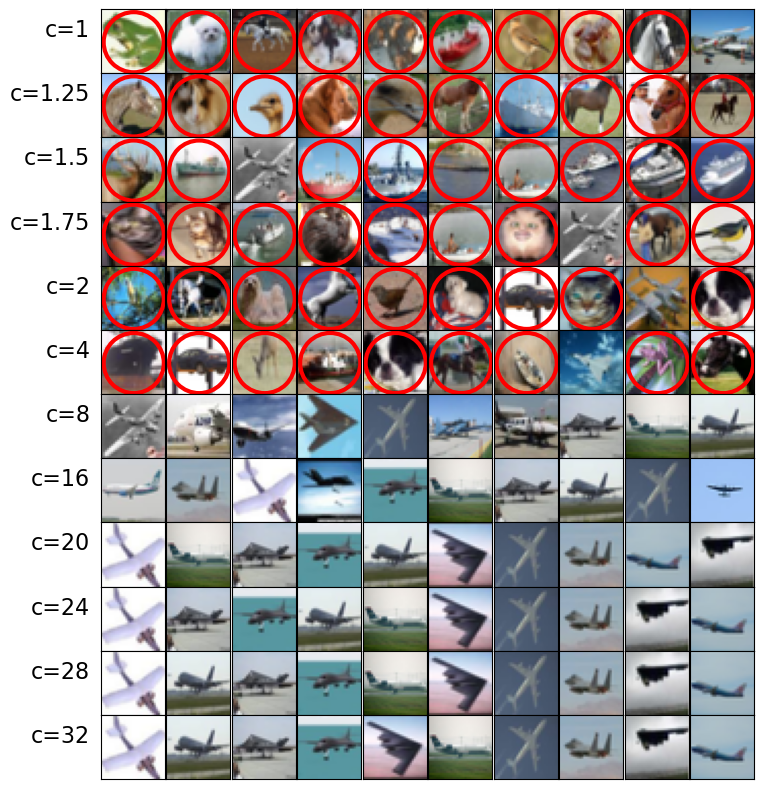

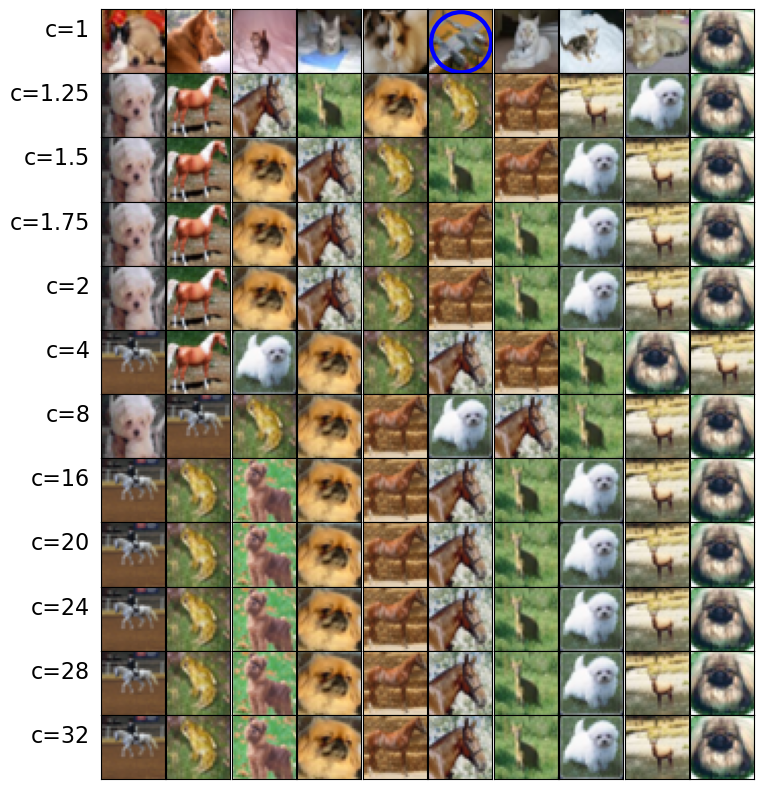

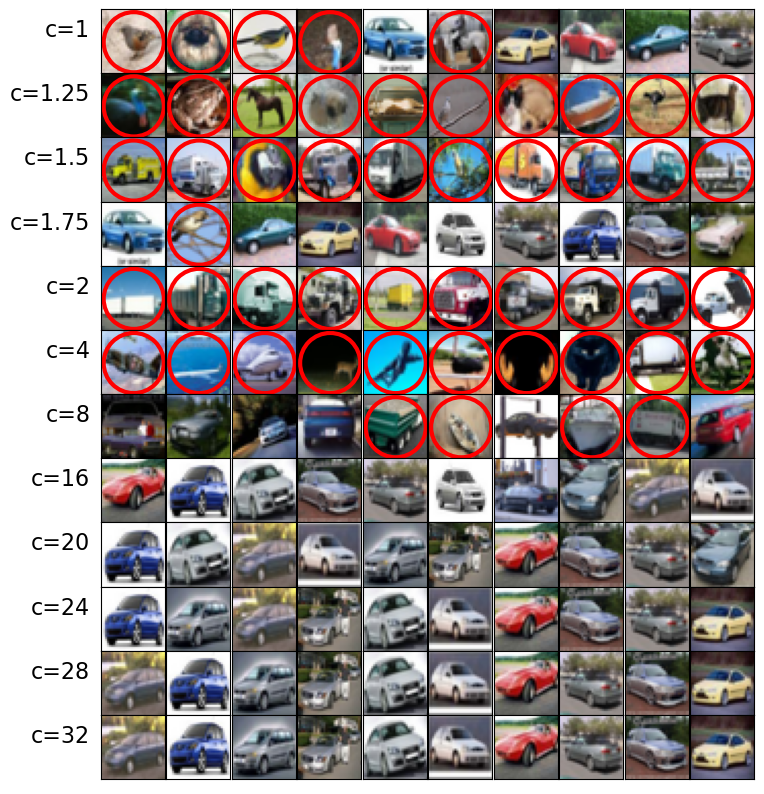

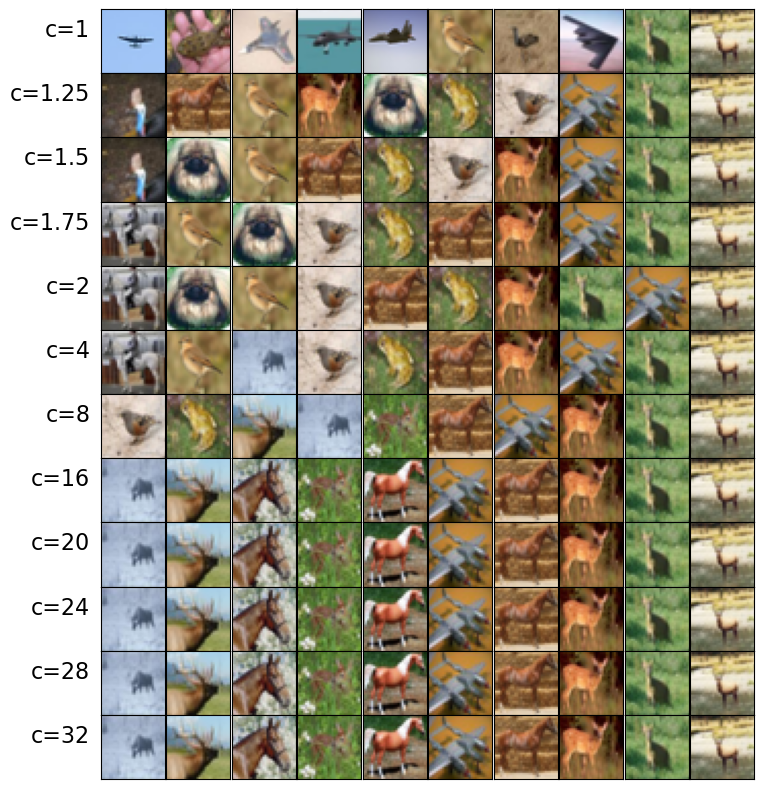

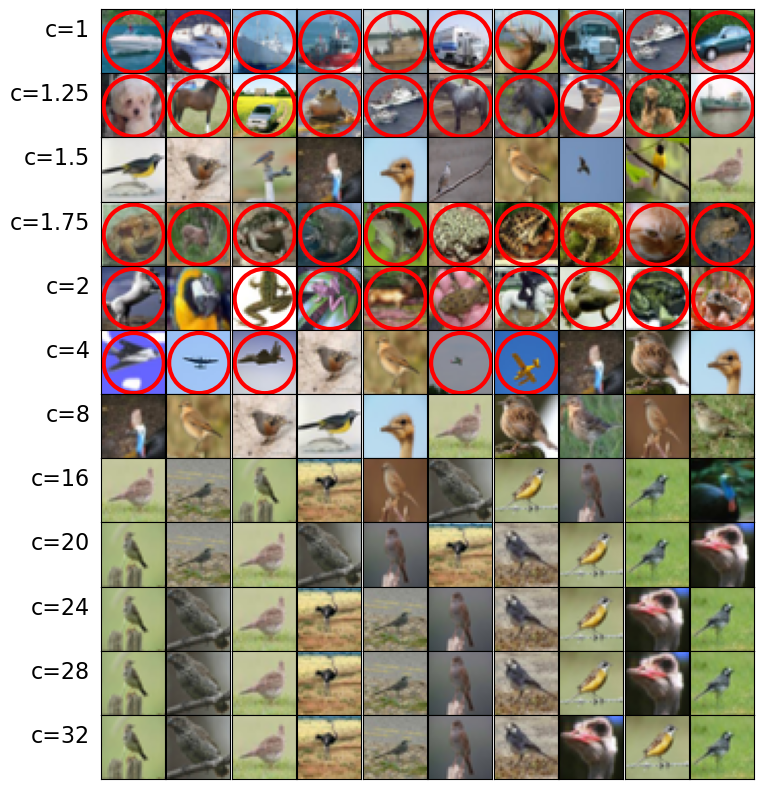

...

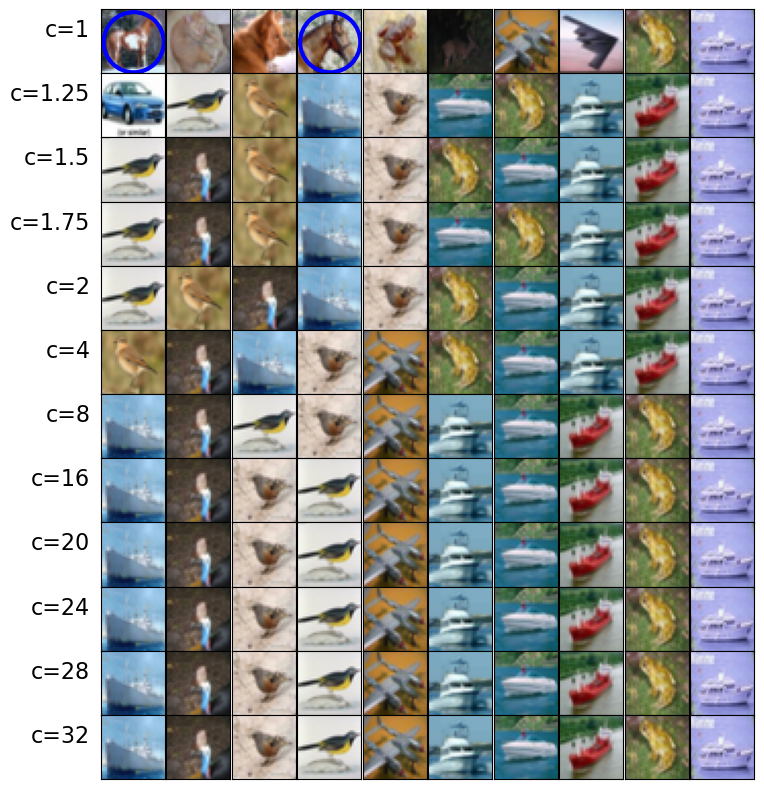

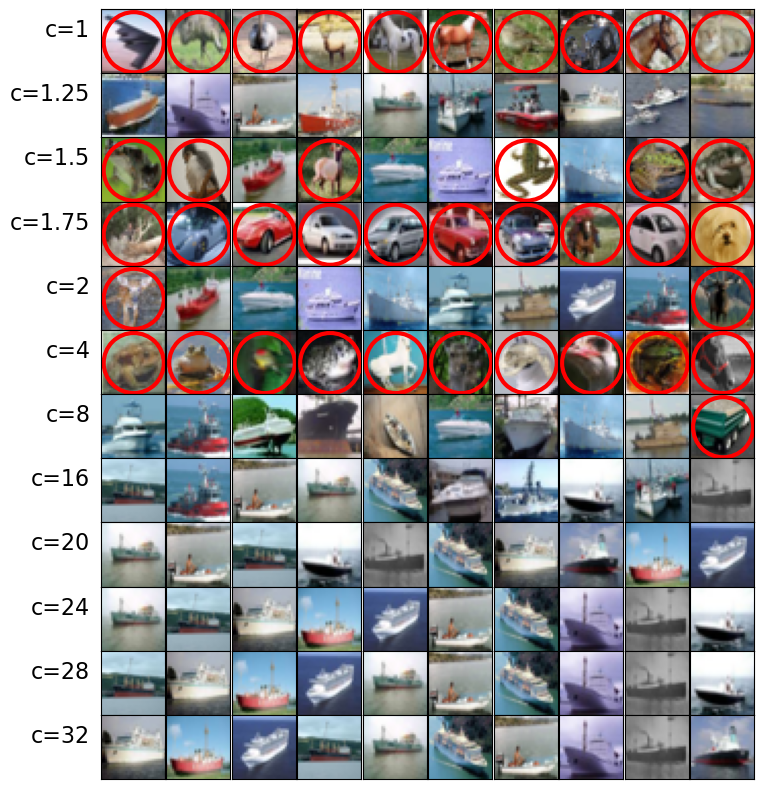

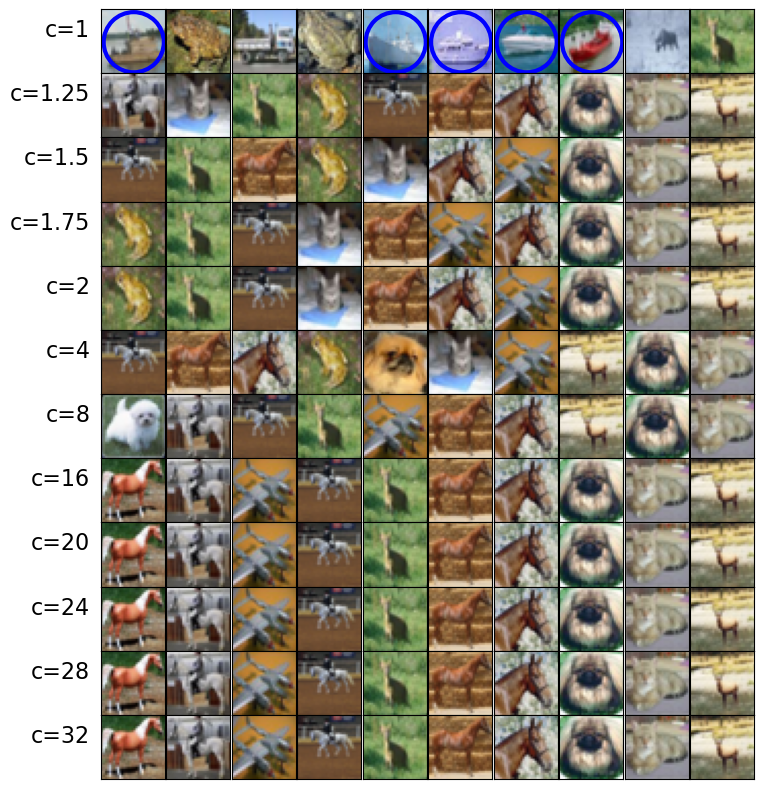

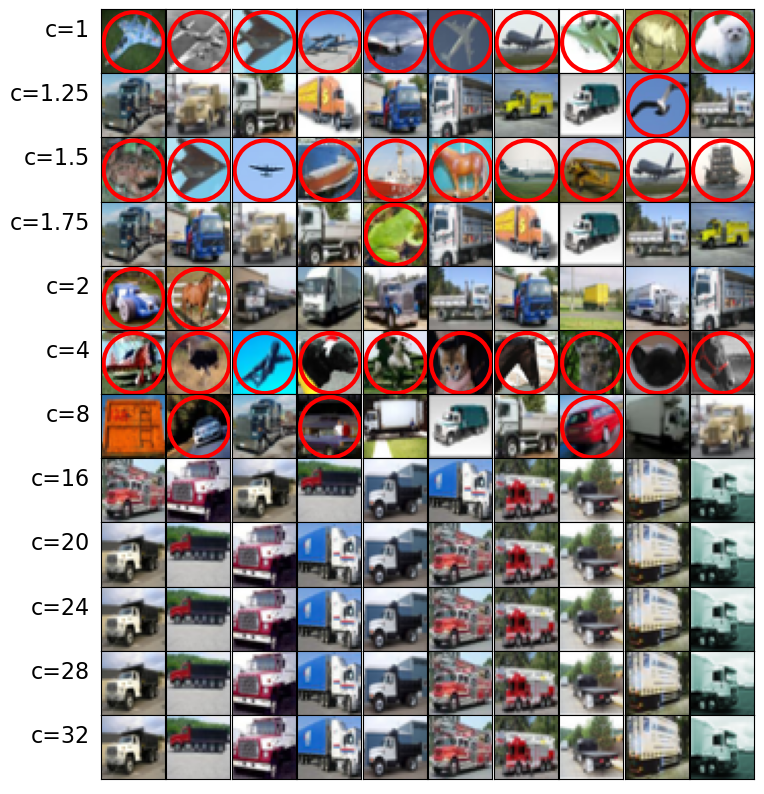

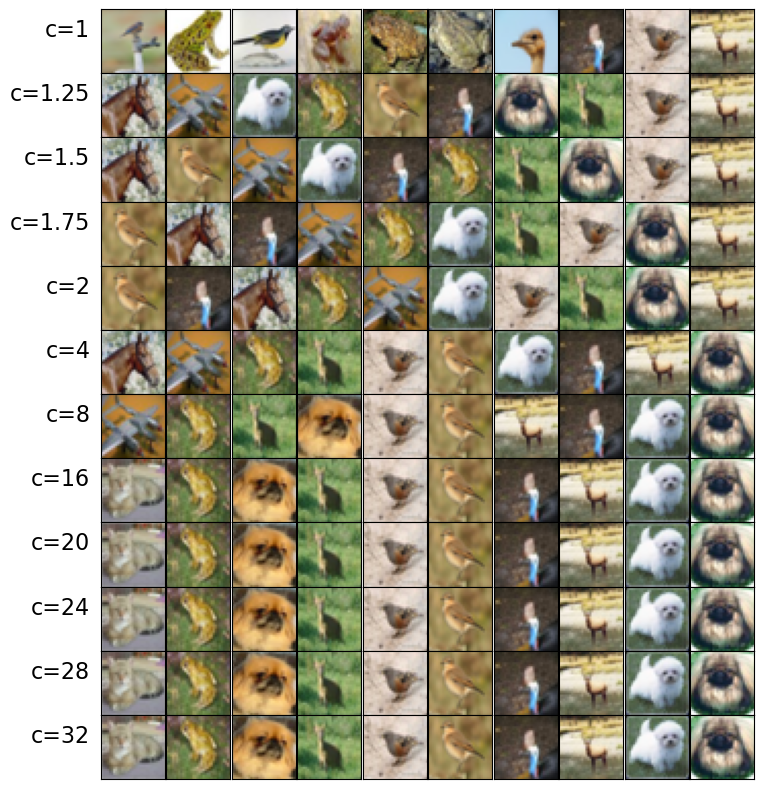

In [5]:
m = 512
n = 512

ints1 = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
# ints1 = [5]


cs = [1, 1.25, 1.5, 1.75, 2, 4, 8, 16, 20, 24, 28, 32]


def normalize(a): return a/np.sum(a)


def distmat(X, Y):
    D = np.sum(X**2, 1)[None, :] + np.sum(Y**2, 1)[:, None] - 2*Y@X.T
    return D.T


# ones_n = np.ones([n, 1])
# ones_m = np.ones([m, 1])
gamma = 1
largest_k = 10
smallest_k = 10
Weights_top_10 = np.zeros([len(ints1), len(cs), largest_k])
weights_bottom_10 = np.zeros([len(ints1), len(cs), largest_k])

rng = np.random.default_rng(42)
y_idx_list = list(rng.choice([r for r in range(0, len(y_test))], n,  replace=False))
Y = x_test_rep[y_idx_list]
label_Y = y_test[y_idx_list]

y_idx_sorted_lst_c_int = {}
y_nu_idx_sorted_lst_c_int = {}
annot_y_sorted_lst_c_int = {}

for i in range(0, len(ints1)):
    int1 = ints1[i]
    print(int1)

    rng = np.random.default_rng(1)
    annot_Y = torch.zeros_like(torch.from_numpy(y_test))
    annot_Y[y_test == int1] = 1

    rng = np.random.default_rng(1)
    x_idx_list = list(rng.choice(np.squeeze(np.argwhere(y_train == int1)), m,))
    X = x_train_rep[x_idx_list]
    label_X = y_train[x_idx_list]

    annot_X = torch.ones_like(torch.from_numpy(y_train))

    mu = np.ones([m, 1])/m
    nu = np.ones([n, 1])/n

    M = np.linalg.norm(X[:, np.newaxis, :] - Y, axis=2, ord=1)
    M = M/np.max(M)
    K = np.exp(-M/(gamma))

    fig, axs = plt.subplots(len(cs), largest_k, figsize=(8.45, 10))
    fig.subplots_adjust(wspace=0, hspace=0)

    fig1, axs1 = plt.subplots(len(cs), largest_k, figsize=(8.45, 10))
    fig1.subplots_adjust(wspace=0, hspace=0)

    y_idx_sorted_lst_c = []
    nu_idx_sorted_lst_c = []
    annot_Y_sorted_lst_c = []

    for l in range(0, len(cs)):
        c = cs[l]
        print("c=",c)
        
        obj, P0, alph, bet = ss_ipot(X, Y, mu, nu, c, gamma=gamma, max_outer_iter=250, max_inner_iter=10, return_map=True)
        print("sum(P)=",np.sum(P0))
        
        P = np.copy(P0)
        nu_hat = np.sum(P, axis=0)
        zipped_sorted_nu_idx = sorted(zip(nu_hat, np.squeeze(y_idx_list)), reverse=True)
        nu_sorted, idx_sorted = list(zip(*zipped_sorted_nu_idx))

        y_idx_sorted_lst_c.append(list(idx_sorted))
        nu_idx_sorted_lst_c.append(list(nu_sorted))
        annot_Y_sorted = annot_Y[list(idx_sorted)]
        annot_Y_sorted_lst_c.append(annot_Y_sorted)

        nu_idx_sorted_10 = list(nu_sorted)[0:largest_k]
        nu_idx_sorted_desc = list(nu_sorted)[-largest_k:]
        annot_Y_sorted = annot_Y[list(idx_sorted)]

        Z = x_test[list(idx_sorted)[0:largest_k]]
        Z1 = x_test[list(idx_sorted)[-largest_k:]]

        annot_Z = annot_Y_sorted[0:largest_k]
        annot_Z1 = annot_Y_sorted[-largest_k:]

        Weights_top_10[i, l, :] = np.array(nu_idx_sorted_10)
        weights_bottom_10[i, l, :] = np.array(nu_idx_sorted_desc)

        for k in range(0, Z.shape[0]):
            if k == 0:
                axs[l, k].imshow(np.squeeze(Z[k]))
                axs[l, k].set_xticks([])
                axs[l, k].set_yticks([])
                ylabel_str = "c={0}".format(c)
                axs[l, k].set_ylabel(ylabel_str, rotation='horizontal', ha='right', fontsize=16)

                axs1[l, k].imshow(np.squeeze(Z1[k]))
                axs1[l, k].set_xticks([])
                axs1[l, k].set_yticks([])
                ylabel_str = "c={0}".format(c)
                axs1[l, k].set_ylabel(ylabel_str, rotation='horizontal', ha='right', fontsize=16)

                if annot_Z[k] == 0:
                    circ = Circle((16, 16), 15,  alpha=1.0,
                                  edgecolor="red",
                                  facecolor="none",
                                  joinstyle="miter",
                                  linewidth=3,)
                    axs[l, k].add_patch(circ)

                if annot_Z1[k] == 1:
                    circ = Circle((16, 16), 15,  alpha=1.0,
                                  edgecolor="blue",
                                  facecolor="none",
                                  joinstyle="miter",
                                  linewidth=3,)
                    axs1[l, k].add_patch(circ)
            else:
                axs[l, k].imshow(np.squeeze(Z[k]))
                axs[l, k].set_xticks([])
                axs[l, k].set_yticks([])

                axs1[l, k].imshow(np.squeeze(Z1[k]))
                axs1[l, k].set_xticks([])
                axs1[l, k].set_yticks([])

                if annot_Z[k] == 0:
                    circ = Circle((16, 16), 15,  alpha=1.0,
                                  edgecolor="red",
                                  facecolor="none",
                                  joinstyle="miter",
                                  linewidth=3,)
                    axs[l, k].add_patch(circ)

                if annot_Z1[k] == 1:
                    circ = Circle((16, 16), 15,  alpha=1.0,
                                  edgecolor="blue",
                                  facecolor="none",
                                  joinstyle="miter",
                                  linewidth=3,)
                    axs1[l, k].add_patch(circ)

    y_idx_sorted_lst_c_int[str(int1)] = y_idx_sorted_lst_c
    y_nu_idx_sorted_lst_c_int[str(int1)] = nu_idx_sorted_lst_c
    annot_y_sorted_lst_c_int[str(int1)] = annot_Y_sorted_lst_c

    file_name1 = "CIFAR_10" + "_f_ipot_Fixed_Target_top="+str(int1)+".pdf"
    file_name2 = "CIFAR_10" + "_f_ipot_Fixed_Target_top="+str(int1)+".svg"
    file_name3 = "CIFAR_10" + "_f_ipot_Fixed_Target_top="+str(int1)+".png"

    file_name4 = "CIFAR_10" + "_f_ipot_Fixed_Target_bottom="+str(int1)+".pdf"
    file_name5 = "CIFAR_10" + "_f_ipot_Fixed_Target_bottom="+str(int1)+".svg"
    file_name6 = "CIFAR_10" + "_f_ipot_Fixed_Target_bottom="+str(int1)+".png"

    fig.savefig(file_name1, dpi=500, bbox_inches='tight', format='pdf')
    fig.savefig(file_name2, dpi=500, bbox_inches='tight', format='svg')
    fig.savefig(file_name3, dpi=500, bbox_inches='tight', format='png')

    fig1.savefig(file_name4, dpi=500, bbox_inches='tight', format='pdf')
    fig1.savefig(file_name5, dpi=500, bbox_inches='tight', format='svg')
    fig1.savefig(file_name6, dpi=500, bbox_inches='tight', format='png')
    


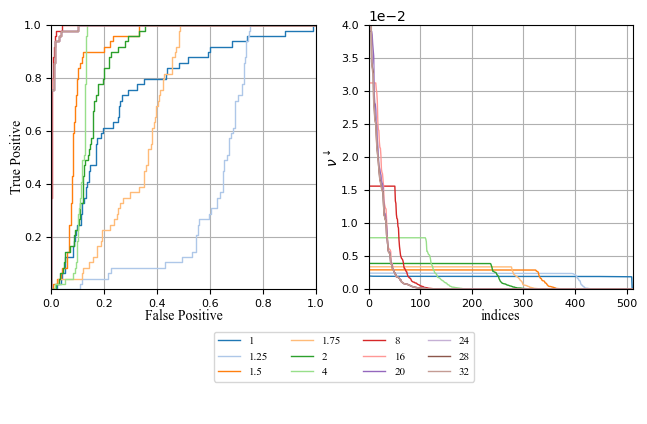

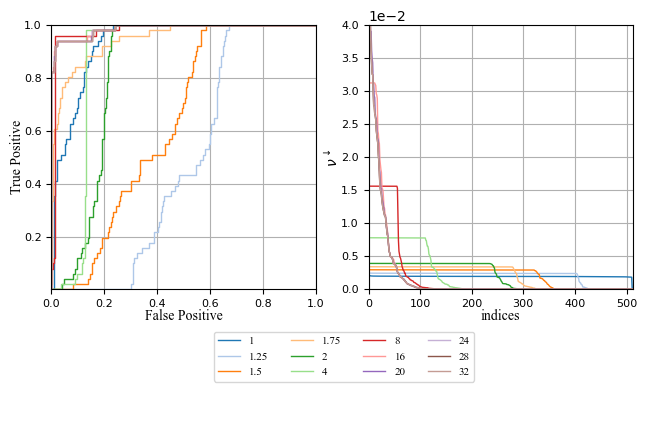

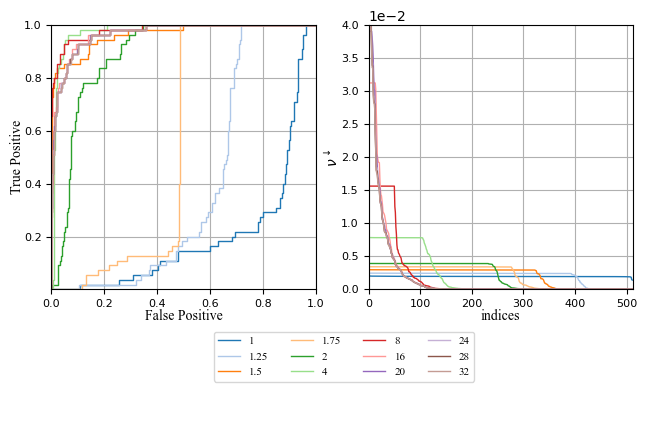

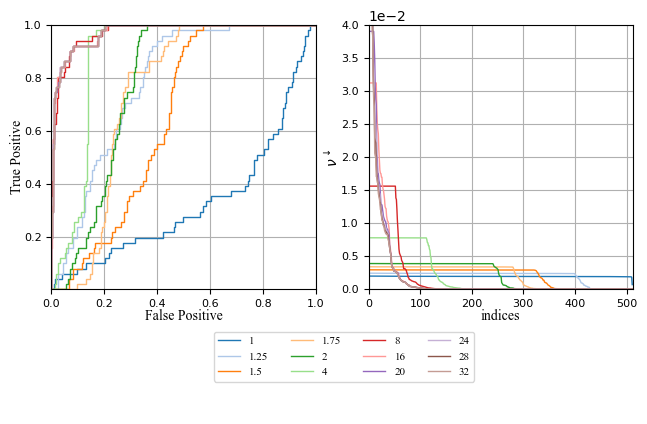

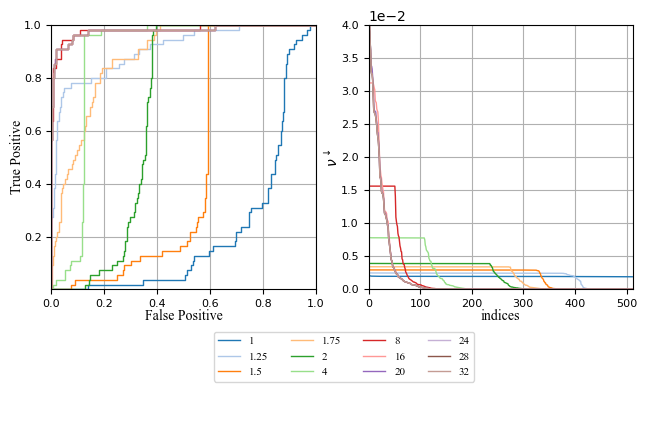

...

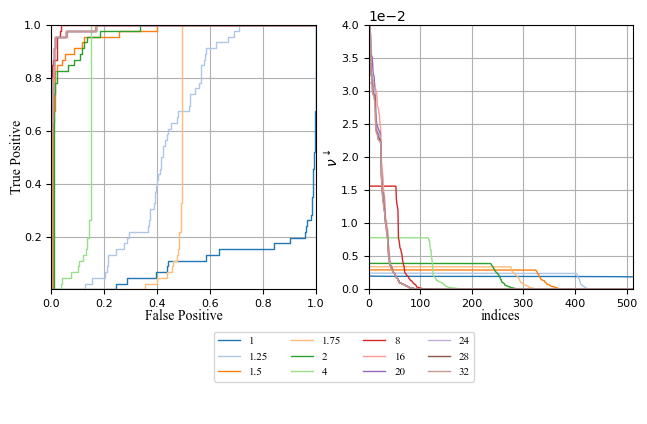

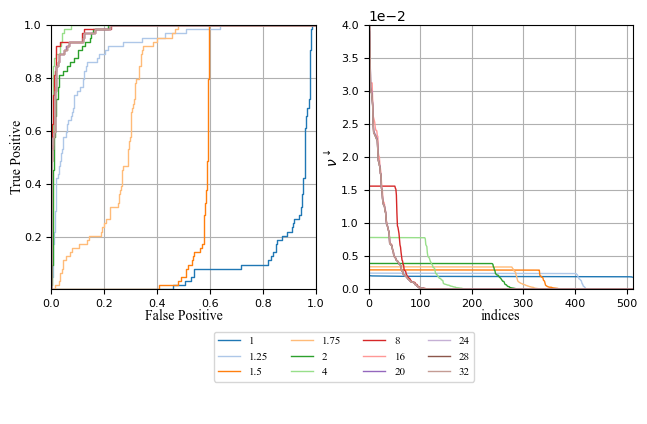

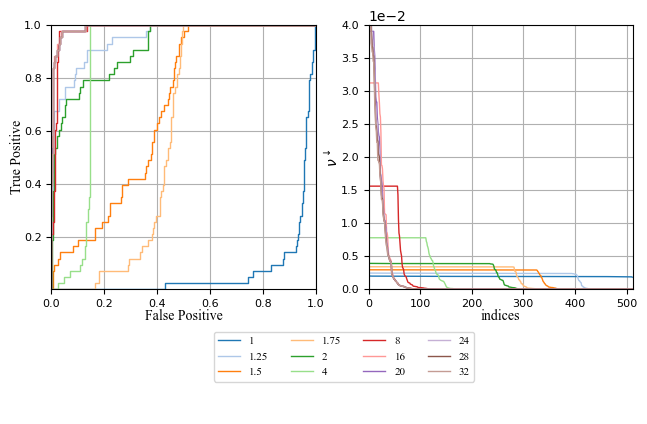

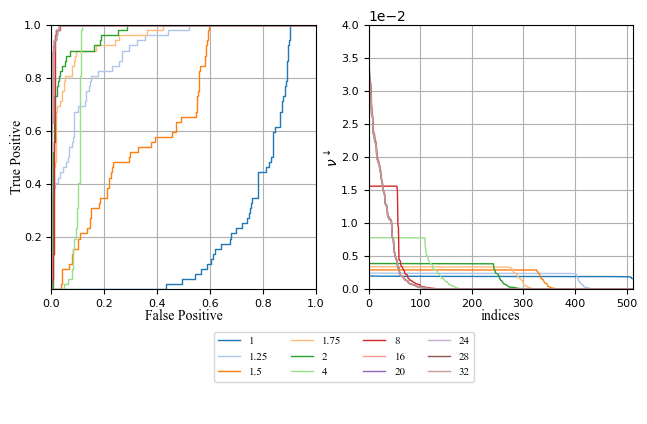

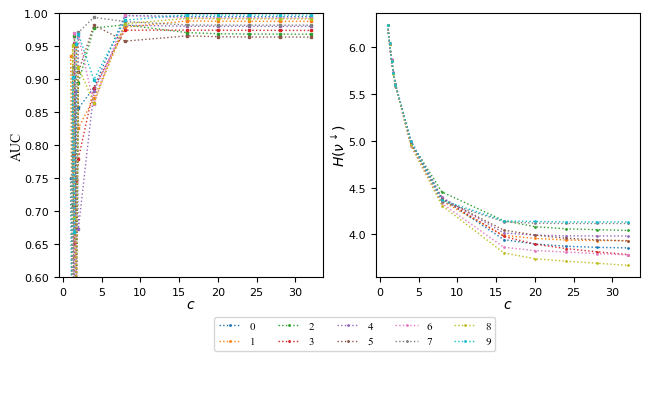

In [6]:
from matplotlib import cm
from sklearn import metrics
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
import matplotlib as mpl
mpl.style.use('default')


font1 = {'family': 'Times New Roman',
         'size': 10}
font2 = {'family': 'Times New Roman',
         'size': 8}
# from sklearn.metrics import RocCurveDisplay
aucs_ints = {}
entropies_ints = {}
# cm = 1/2.54

# cm_subsection = np.linspace(0, len(cs), 100*len(cs))
# colors0 = [cm.jet(x) for x in cm_subsection]
colors0 = mpl.cm.tab20(range(20))

ints1 = [0,1,2,3,4,5,6,7,8,9]
# ints1 = [5]
for int in ints1:
    fig, axs = plt.subplots(1, 2, figsize=(7.5, 6.5))
    aucs = []
    ents = []
    y_idx_sorted_lst_c = y_idx_sorted_lst_c_int[str(int)] 
    nu_idx_sorted_lst_c = y_nu_idx_sorted_lst_c_int[str(int)] 
    annot_Y_sorted_lst_c = annot_y_sorted_lst_c_int[str(int)]
    for i in range(len(cs)):
        sorted_idx_lst = y_idx_sorted_lst_c[i]
        nu_sorted = np.array(nu_idx_sorted_lst_c[i])
        annot_Y_sorted = np.array(annot_Y_sorted_lst_c[i])
        fpr, tpr, _ = roc_curve(annot_Y_sorted, nu_sorted, pos_label=1)
        aucs.append(roc_auc_score(annot_Y_sorted, nu_sorted))
        ents.append(-np.sum(np.log(nu_sorted**nu_sorted)))

        aucs_ints[str(int)] = aucs
        entropies_ints[str(int)] = ents

        axs[0].plot(fpr, tpr, linewidth=1, color=colors0[i], label=str(cs[i]) )
        # axs.set_title("Subset Selection")
        axs[0].set_xlabel("False Positive", labelpad=0.01, **font1)
        axs[0].set_xlim([0, 1])
        axs[0].set_ylim([0, 1])
        axs[0].set_yticks([ 0.2, 0.4, 0.6, 0.8, 1.0])
        axs[0].grid(True)
        axs[0].set_ylabel("True Positive", labelpad=0.01, **font1)
        # axs[0].legend(loc=(0.50, 0.05), prop={'family': 'Times New Roman', 'weight': 'normal', 'size': 8}, ncol=2, frameon=True)
        axs[0].set_box_aspect(1)
        
        axs[1].plot(list(range(0, nu_sorted.size)), nu_sorted, linewidth=1, color=colors0[i])
        axs[1].set_xlabel("indices", labelpad=0.01, **font1)
        axs[1].set_xlim([0, nu_sorted.size])
        axs[1].set_ylim([0, 0.040])
        axs[1].ticklabel_format(style='sci', axis='y', scilimits=(0, 0))
        # axs[1].set_yticks([ 0.2, 0.4, 0.6, 0.8, 1.0])
        axs[1].grid(True)
        axs[1].set_ylabel("$\\nu^{\downarrow}$", labelpad=0.01, **font1)
        # axs[1].legend(loc=(0.55, 0.65), prop={'family': 'Times New Roman', 'weight': 'normal', 'size': 8}, ncol=2, frameon=True)
        axs[1].set_box_aspect(1)
        
    axs[0].tick_params(axis='both', which='major', labelsize=8)
    axs[1].tick_params(axis='both', which='major', labelsize=8)
    fig.subplots_adjust(hspace=0.1, wspace=0.2)
    fig.legend(loc=(0.33, 0.10), prop=font2, ncol=4, frameon=True)
    # fig.legend(loc = (0.25,0.001), prop =font1, ncol=4, frameon=False)
    file_name1 = "CIFAR_10" + "ipot_ROC_"+str(int)+".pdf"
    file_name2 = "CIFAR_10" + "ipot_ROC_"+str(int)+".svg"
    file_name3 = "CIFAR_10" + "ipot_ROC_"+str(int)+".png"
    
    fig.savefig(file_name1, dpi=500, bbox_inches='tight', format='pdf')
    fig.savefig(file_name2, dpi=500, bbox_inches='tight', format='svg')
    fig.savefig(file_name3, dpi=500, bbox_inches='tight', format='png')
    
    
colors1 = mpl.cm.tab10(range(20))
fig1, axs1 = plt.subplots(1, 2, figsize=(7.5, 6.5))

for int in ints1:
    axs1[0].plot(cs, aucs_ints[str(int)],  linewidth=1, linestyle='dotted', marker="s",  markersize=2)
    axs1[1].plot(cs, entropies_ints[str(int)], linewidth=1, linestyle='dotted', marker=".", markersize=2,  label = str(int))
    axs1[0].set_xlabel("$c$", labelpad=0.01, **font1)
    axs1[0].set_ylabel("AUC", labelpad=0.01, **font1)
    axs1[0].tick_params(axis='both', which='major', labelsize=8)
    # axs1[0].legend(loc=(0.55, 0.10), prop={'family': 'Times New Roman', 'weight': 'normal', 'size': 8}, ncol=2, frameon=True)
    axs1[0].set_box_aspect(1)
    axs1[0].set_ylim([0.6,1])
    
    axs1[1].set_xlabel("$c$", labelpad=0.01, **font1)
    axs1[1].set_ylabel("$H(\\nu^{\downarrow})$", labelpad=0.01, **font1)
    axs1[1].tick_params(axis='both', which='major', labelsize=8)
    axs1[1].set_box_aspect(1)
    # axs1[1].legend(loc=(0.55, 0.65), prop={'family': 'Times New Roman', 'weight': 'normal', 'size': 8}, ncol=2, frameon=True)
    
    
fig1.subplots_adjust(hspace=0.1, wspace=0.2)
fig1.legend(loc=(0.33, 0.12), prop=font2, ncol=5, frameon=True)
file_name4 = "CIFAR_10" + "ipot_AUC_c"+".pdf"
file_name5 = "CIFAR_10" + "ipot_AUC_c"+".svg"
file_name6 = "CIFAR_10" + "ipot_AUC_c"+".png"
fig1.savefig(file_name4, dpi=500, bbox_inches='tight', format='pdf')
fig1.savefig(file_name5, dpi=500, bbox_inches='tight', format='svg')
fig1.savefig(file_name6, dpi=500, bbox_inches='tight', format='png')


# paper plot

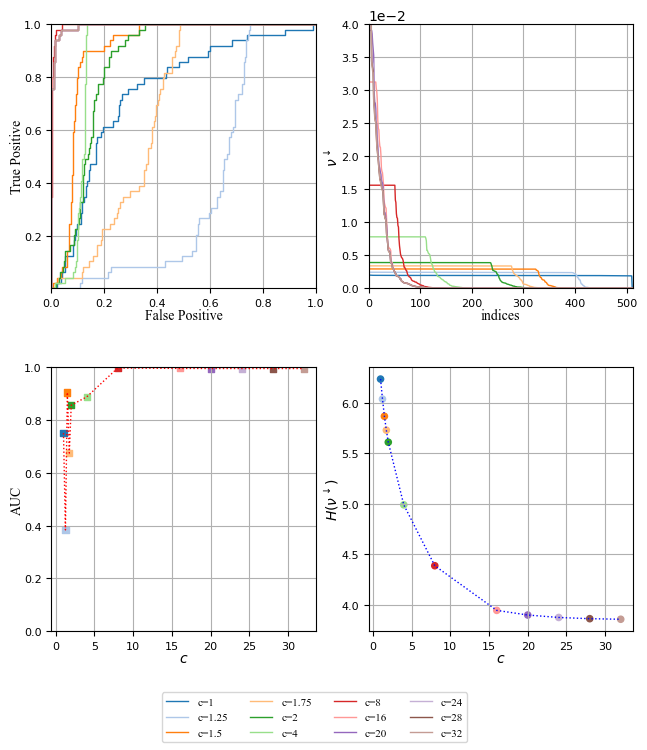

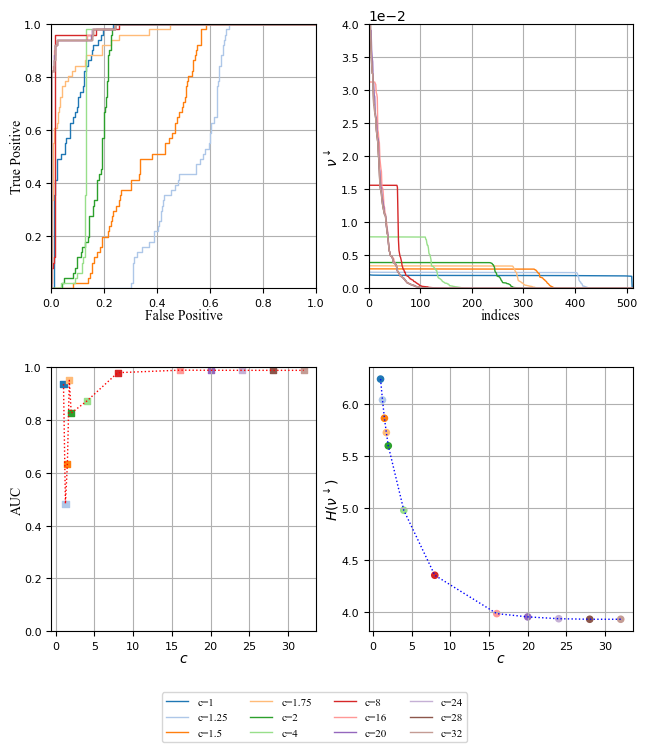

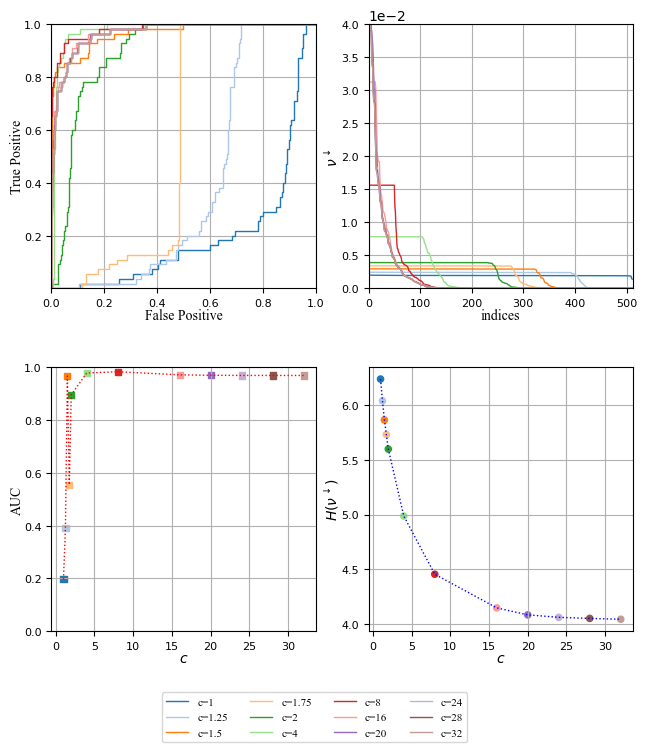

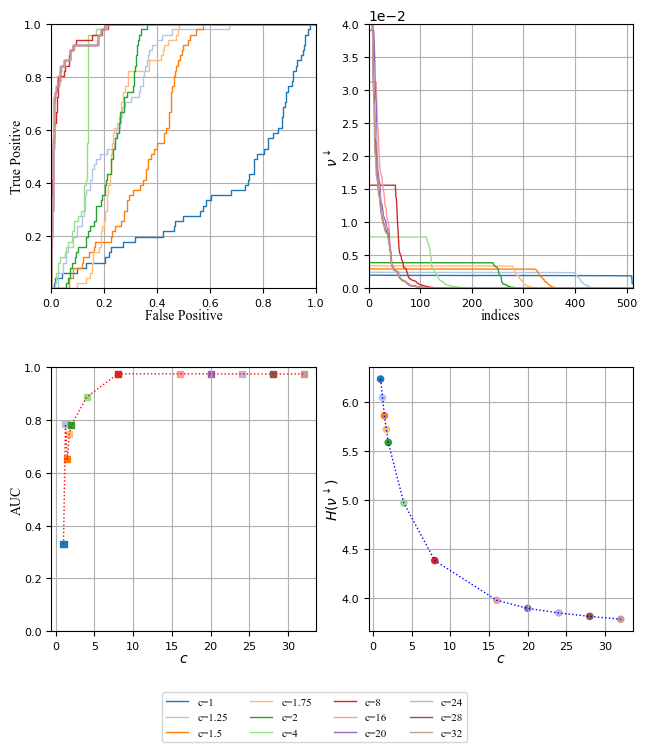

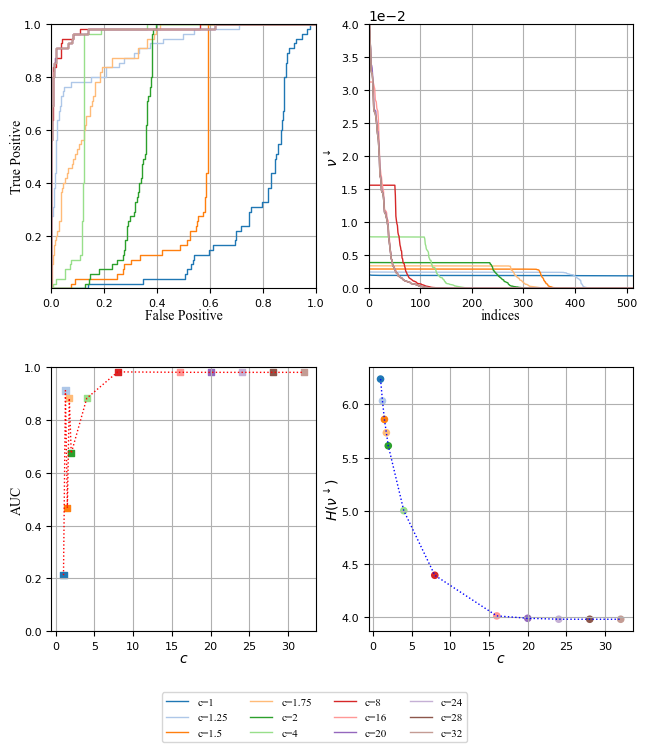

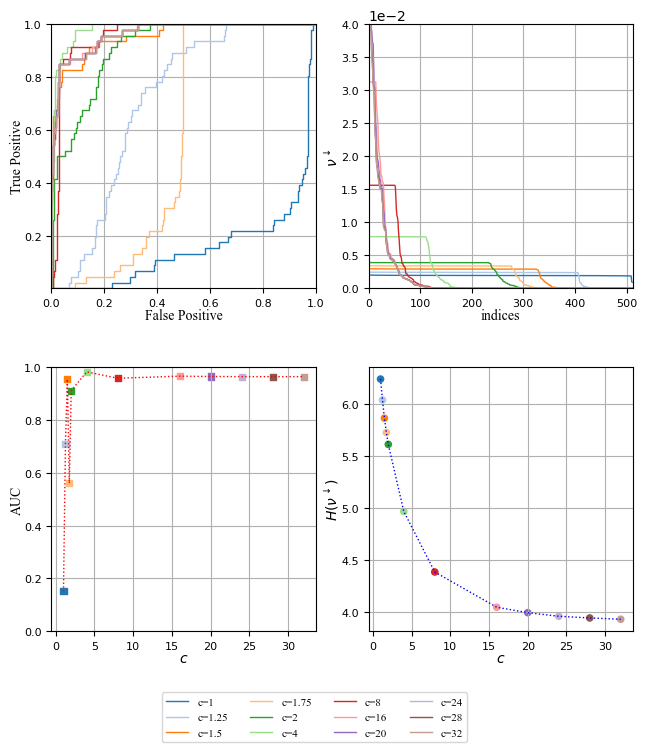

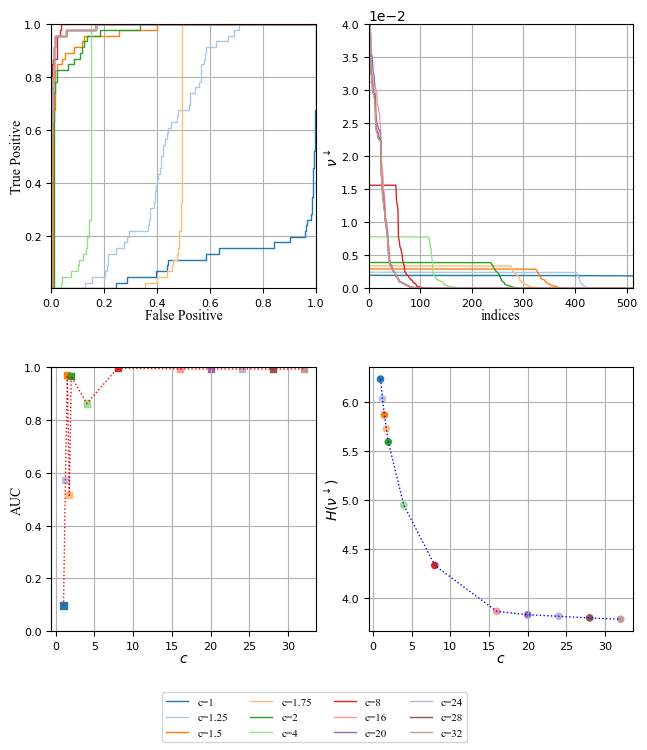

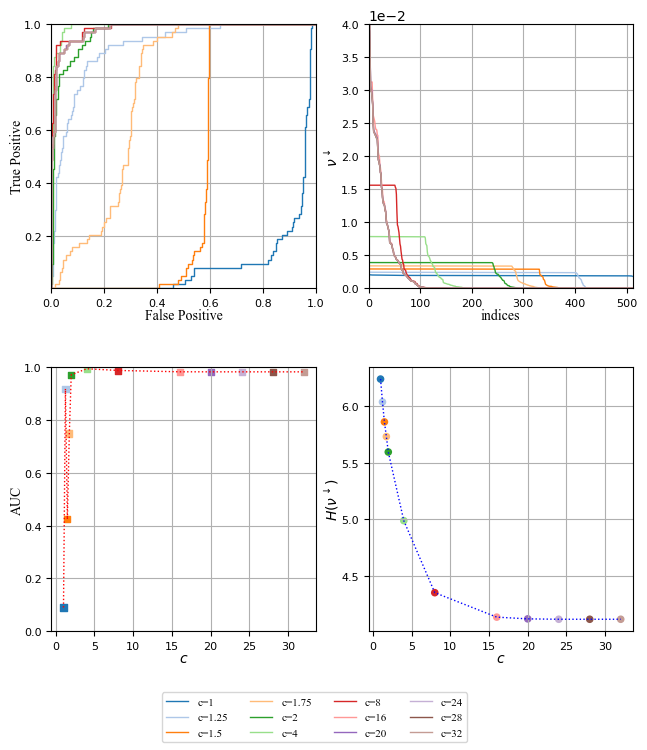

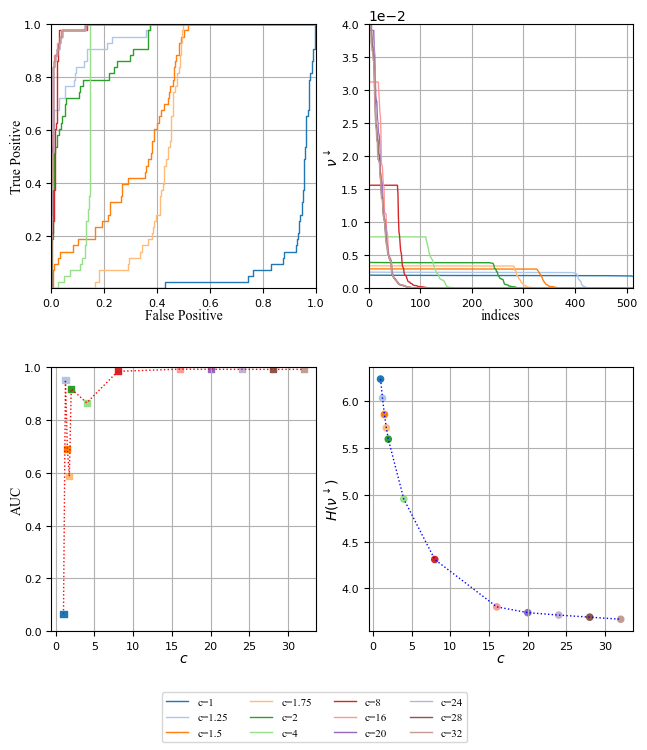

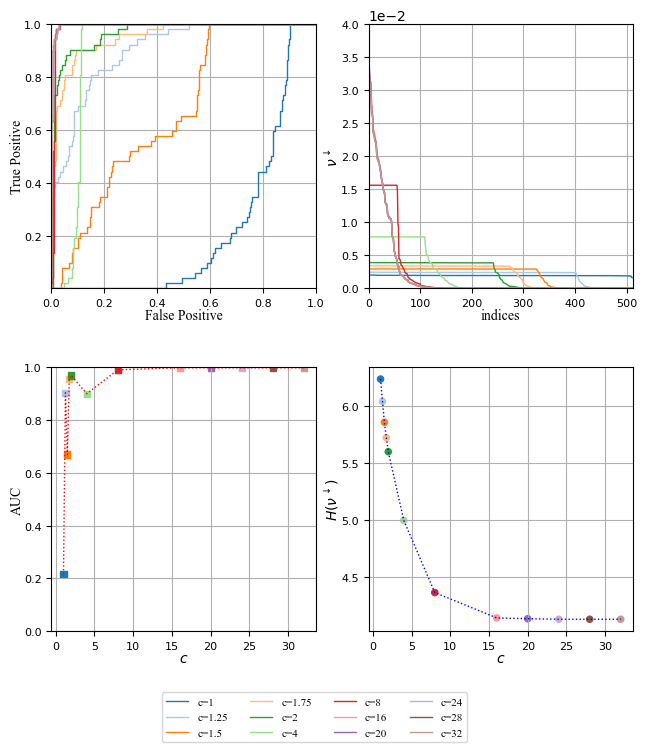

In [8]:
from matplotlib import cm
from sklearn import metrics
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
import matplotlib as mpl
mpl.style.use('default')


font1 = {'family': 'Times New Roman',
         'size': 10}
font2 = {'family': 'Times New Roman',
         'size': 8}
# from sklearn.metrics import RocCurveDisplay
aucs_ints = {}
entropies_ints = {}
# cm = 1/2.54

# cm_subsection = np.linspace(0, len(cs), 100*len(cs))
# colors0 = [cm.jet(x) for x in cm_subsection]
colors0 = mpl.cm.tab20(range(20))

ints1 = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
# ints1 = [5]
for int in ints1:
    fig, axs = plt.subplots(2, 2, figsize=(7.5, 8.5))
    aucs = []
    ents = []
    y_idx_sorted_lst_c = y_idx_sorted_lst_c_int[str(int)]
    nu_idx_sorted_lst_c = y_nu_idx_sorted_lst_c_int[str(int)]
    annot_Y_sorted_lst_c = annot_y_sorted_lst_c_int[str(int)]
    for i in range(len(cs)):
        sorted_idx_lst = y_idx_sorted_lst_c[i]
        nu_sorted = np.array(nu_idx_sorted_lst_c[i])
        annot_Y_sorted = np.array(annot_Y_sorted_lst_c[i])
        fpr, tpr, _ = roc_curve(annot_Y_sorted, nu_sorted, pos_label=1)
        aucs.append(roc_auc_score(annot_Y_sorted, nu_sorted))
        ents.append(-np.sum(np.log(nu_sorted**nu_sorted)))

        aucs_ints[str(int)] = aucs
        entropies_ints[str(int)] = ents

        axs[0, 0].plot(fpr, tpr, linewidth=1, color=colors0[i], label="c="+str(cs[i]))
        # axs.set_title("Subset Selection")
        axs[0, 0].set_xlabel("False Positive", labelpad=0.01, **font1)
        axs[0, 0].set_xlim([0, 1])
        axs[0, 0].set_ylim([0, 1])
        axs[0, 0].set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
        axs[0, 0].grid(True)
        axs[0, 0].set_ylabel("True Positive", labelpad=0.01, **font1)
        # axs[0].legend(loc=(0.50, 0.05), prop={'family': 'Times New Roman', 'weight': 'normal', 'size': 8}, ncol=2, frameon=True)
        axs[0, 0].set_box_aspect(1)

        axs[0, 1].plot(list(range(0, nu_sorted.size)),
                    nu_sorted, linewidth=1, color=colors0[i])
        axs[0, 1].set_xlabel("indices", labelpad=0.01, **font1)
        axs[0, 1].set_xlim([0, nu_sorted.size])
        axs[0, 1].set_ylim([0, 0.040])
        axs[0, 1].ticklabel_format(style='sci', axis='y', scilimits=(0, 0))
        # axs[1].set_yticks([ 0.2, 0.4, 0.6, 0.8, 1.0])
        axs[0, 1].grid(True)
        axs[0, 1].set_ylabel("$\\nu^{\downarrow}$", labelpad=0.01, **font1)
        # axs[1].legend(loc=(0.55, 0.65), prop={'family': 'Times New Roman', 'weight': 'normal', 'size': 8}, ncol=2, frameon=True)
        axs[0, 1].set_box_aspect(1)
        
        

    axs[0, 0].tick_params(axis='both', which='major', labelsize=8)
    axs[0, 1].tick_params(axis='both', which='major', labelsize=8)
    fig.subplots_adjust(hspace=0.1, wspace=0.2)
    
    colors1 = mpl.cm.tab10(range(20))
    # fig1, axs1 = plt.subplots(1, 2, figsize=(7.5, 6.5))

    # axs[1, 0].plot(cs, aucs_ints[str(int)],  color = "r", linewidth=1,linestyle='dotted', marker="s",  markersize=2)
    # axs[1, 1].plot(cs, entropies_ints[str(int)], color = "b", linewidth=1, linestyle='dotted', marker=".", markersize=2)
    
    axs[1,0].plot(cs, aucs, linewidth=1, color = "r", linestyle='dotted')
    axs[1, 0].scatter(cs, aucs, marker="s", s=20, c=colors0[0:len(cs)])
    
    axs[1, 1].plot(cs, entropies_ints[str(int)], color='b', linewidth=1, linestyle='dotted')
    axs[1, 1].scatter(cs, entropies_ints[str(int)], marker="o", s=20, c=colors0[0:len(cs)])
    
    
    axs[1, 0].grid(True)
    axs[1, 1].grid(True)
    axs[1, 0].set_xlabel("$c$", labelpad=0.01, **font1)
    axs[1, 0].set_ylabel("AUC", labelpad=0.01, **font1)
    axs[1, 0].tick_params(axis='both', which='major', labelsize=8)
    # axs1[0].legend(loc=(0.55, 0.10), prop={'family': 'Times New Roman', 'weight': 'normal', 'size': 8}, ncol=2, frameon=True)
    axs[1, 0].set_box_aspect(1)
    axs[1, 0].set_ylim([0, 1])

    axs[1, 1].set_xlabel("$c$", labelpad=0.01, **font1)
    axs[1, 1].set_ylabel("$H(\\nu^{\downarrow})$", labelpad=0.01, **font1)
    axs[1, 1].tick_params(axis='both', which='major', labelsize=8)
    axs[1, 1].set_box_aspect(1)
    # axs1[1].legend(loc=(0.55, 0.65), prop={'family': 'Times New Roman', 'weight': 'normal', 'size': 8}, ncol=2, frameon=True)

    # fig.legend(loc=(0.33, 0.10), prop=font2, ncol=4, frameon=True)
    fig.legend(loc = (0.25,0.01), prop =font2, ncol=4, frameon=True)
    file_name1 = "CIFAR_10" + "ipot_AUROC_"+str(int)+".pdf"
    file_name2 = "CIFAR_10" + "ipot_AUROC_"+str(int)+".svg"
    file_name3 = "CIFAR_10" + "ipot_UROC_"+str(int)+".png"

    fig.savefig(file_name1, dpi=500, bbox_inches='tight', format='pdf')
    fig.savefig(file_name2, dpi=500, bbox_inches='tight', format='svg')
    fig.savefig(file_name3, dpi=500, bbox_inches='tight', format='png')


# fig.subplots_adjust(hspace=0.1, wspace=0.2)
# fig.legend(loc='lower center', prop=font2, ncol=5, frameon=True)
# file_name4 = "CIFAR_10" + "fig2"+".pdf"
# file_name5 = "CIFAR_10" + "fig2"+".svg"
# file_name6 = "CIFAR_10" + "fig2"+".png"
# fig1.savefig(file_name4, dpi=500, bbox_inches='tight', format='pdf')
# fig1.savefig(file_name5, dpi=500, bbox_inches='tight', format='svg')
# fig1.savefig(file_name6, dpi=500, bbox_inches='tight', format='png')


# IPOT C

In [ ]:
# m = 512
# n = 512

# ints1 = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
# # ints1 = [0]


# cs = [16, 20, 24, 28, 32, 64]


# def normalize(a): return a/np.sum(a)


# def distmat(X, Y):
#     D = np.sum(X**2, 1)[None, :] + np.sum(Y**2, 1)[:, None] - 2*Y@X.T
#     return D.T


# # ones_n = np.ones([n, 1])
# # ones_m = np.ones([m, 1])
# lambd = 0.1
# largest_k = 10
# smallest_k = 10
# Weights_top_10 = np.zeros([len(ints1), len(cs), largest_k])
# weights_bottom_10 = np.zeros([len(ints1), len(cs), smallest_k])


# rng = np.random.default_rng(0)
# y_idx_list = list(rng.choice(
#     [r for r in range(0, len(y_test))], n,  replace=False))
# Y = x_test_rep[y_idx_list]
# label_Y = y_test[y_idx_list]


# for i in range(0, len(ints1)):
#     int1 = ints1[i]
#     print(int1)
#     rng = np.random.default_rng(1)
#     # x_idx_list = list(rng.choice([r for r in range(0,np.sum(y_train==int1))], m,  replace = False))
#     # X = x_train_rep[y_train==int1][x_idx_list]
#     # label_X = y_train[y_train==int1][x_idx_list]

#     rng = np.random.default_rng(1)
#     x_idx_list = list(rng.choice(np.squeeze(np.argwhere(y_train == int1)), m,))
#     X = x_train_rep[x_idx_list]
#     label_X = y_train[x_idx_list]

#     # np.random.seed(1)
#     # a = np.random.rand(m,1)
#     # mu = a/np.sum(a)

#     mu = np.ones([m, 1])/m
#     nu = np.ones([n, 1])/n

#     # rng = np.random.default_rng(0)
#     # y_idx_list = list(rng.choice([r for r in range(0, len(y_test))], n,  replace=False))
#     # Y = x_test_rep[y_idx_list]
#     # label_Y = y_test[y_idx_list]

#     # M = np.linalg.norm(X[:, np.newaxis, :] - Y, axis=2, ord=1)
#     # M = M/np.max(M)
#     # K = np.exp(-M/(gamma))

#     fig, axs = plt.subplots(len(cs), largest_k, figsize=(15, 12))
#     fig.subplots_adjust(left=0.5, bottom=0.5, right=1.1, top=1.2)

#     fig1, axs1 = plt.subplots(len(cs), largest_k, figsize=(15, 12))
#     fig1.subplots_adjust(left=0.5, bottom=0.5, right=1.1, top=1.2)
#     # fig.subplots_adjust(hspace=.5, wspace=.4)
#     # params = {
#     #     #  'axes.labelsize': 10,
#     #     'axes.titlesize': 12,
#     #     "font.family": "Times New Roman"
#     # }
#     # plt.rcParams.update(params)

#     # zero corresponds to entropic case and 1 corresponds to quadratic case

#     for l in range(0, len(cs)):
#         c = cs[l]
#         # subset_select_non_uniform_FISTA(mu, nu, c, K, M, gamma=1e-1, Lt=1e-1, eta = 1.1, max_iter = 20000, back_tracking = False, disp_iter=False):

#         # P0, obj, alph, bet = ss(mu, nu, c, K,  M, gamma=gamma, Lt=1 /
#         #                         gamma, max_iter=5000, back_tracking=False, disp_iter=False)

#         obj, P0, alph, bet = ss_ipot(X, Y, mu, nu, c, gamma=lambd, max_outer_iter=100, max_inner_iter=100, return_map=True)

#         P = np.copy(P0)

#         nu_hat = np.sum(P, axis=0)

#         zipped_sorted_nu_idx = sorted(
#             zip(nu_hat, np.squeeze(y_idx_list)), reverse=True)
#         nu_sorted, idx_sorted = list(zip(*zipped_sorted_nu_idx))

#         nu_idx_sorted_10 = list(nu_sorted)[0:largest_k]
#         nu_idx_sorted_desc = list(nu_sorted)[-largest_k:]

#         Z = x_test[list(idx_sorted)[0:largest_k]]
#         Z1 = x_test[list(idx_sorted)[-largest_k:]]
#         Weights_top_10[i, l, :] = np.array(nu_idx_sorted_10)
#         weights_bottom_10[i, l, :] = np.array(nu_idx_sorted_desc)

#         for k in range(0, Z.shape[0]):
#             if k == 0:
#                 axs[l, k].imshow(np.squeeze(Z[k]))
#                 axs[l, k].set_xticks([])
#                 axs[l, k].set_yticks([])
#                 ylabel_str = "c = {0}".format(c)
#                 axs[l, k].set_ylabel(ylabel_str, weight="bold")
#                 # xlabel_str = "$\\nu_{{[{0}]}}$ = {1:0.3f}".format(
#                 #     k, Weights_top_10[i, l, k])
#                 # axs[l, k].set_xlabel(xlabel_str, fontsize=10, labelpad=-4)

#                 str_title = "$y = {0}, \hat y$ = {1}".format(
#                     y_test[idx_sorted[k]].item(), y_test_pred[idx_sorted[k]].item())
#                 axs[l, k].set_title(str_title, fontsize=9, pad=-5)
#                 axs[l, k].set_box_aspect(1)

#                 axs1[l, k].imshow(np.squeeze(Z1[k]))
#                 axs1[l, k].set_xticks([])
#                 axs1[l, k].set_yticks([])
#                 ylabel_str = "c = {0}".format(c)
#                 axs1[l, k].set_ylabel(ylabel_str, weight="bold")
#                 # xlabel_str = "$\\nu_{{[{0}]}}$ = {1:0.3f}".format(
#                 #     k, Weights_top_10[i, l, k])
#                 # axs1[l, k].set_xlabel(xlabel_str, fontsize=10, labelpad=-4)

#                 str_title = "$y = {0}, \hat y$ = {1}".format(
#                     y_test[idx_sorted[k]].item(), y_test_pred[idx_sorted[k]].item())
#                 axs1[l, k].set_title(str_title, fontsize=9, pad=-5)
#                 axs1[l, k].set_box_aspect(1)
#             else:
#                 axs[l, k].imshow(np.squeeze(Z[k]))
#                 axs[l, k].set_xticks([])
#                 axs[l, k].set_yticks([])
#                 # xlabel_str = "$\\nu_{{[{0}]}}$ = {1:0.3f}".format(
#                 #     k, Weights_top_10[i, l, k])
#                 # axs[l, k].set_xlabel(xlabel_str, fontsize=8, labelpad=-4)

#                 str_title = "y = {0}, $\hat y$ = {1}".format(
#                     y_test[idx_sorted[k]].item(), y_test_pred[idx_sorted[k]].item())
#                 axs[l, k].set_title(str_title, fontsize=9, pad=-5)
#                 axs[l, k].set_box_aspect(1)

#                 axs1[l, k].imshow(np.squeeze(Z1[k]))
#                 axs1[l, k].set_xticks([])
#                 axs1[l, k].set_yticks([])
#                 # xlabel_str = "$\\nu_{{[{0}]}}$ = {1:0.3f}".format(
#                 #     k, Weights_top_10[i, l, k])
#                 # axs1[l, k].set_xlabel(xlabel_str, fontsize=8, labelpad=-4)

#                 str_title = "y = {0}, $\hat y$ = {1}".format(
#                     y_test[idx_sorted[k]].item(), y_test_pred[idx_sorted[k]].item())
#                 axs1[l, k].set_title(str_title, fontsize=9, pad=-5)
#                 axs1[l, k].set_box_aspect(1)

#         # file_name1 = "CIFAR_10"+"Fixed_Target="+str(int2)+"L="+str(L)+".pdf"
#         # file_name2 = "CIFAR_10"+"Fixed_Target="+str(int2)+"L="+str(L)+".svg"
#     file_name1 = "CIFAR_10" + "_f_ipotC_Fixed_Target_top="+str(int1)+".pdf"
#     file_name2 = "CIFAR_10" + "_f_ipotC_Fixed_Target_top="+str(int1)+".svg"
#     file_name3 = "CIFAR_10" + "_f_ipotC_Fixed_Target_top="+str(int1)+".png"

#     file_name4 = "CIFAR_10" + "_f_ipotC_Fixed_Target_bottom="+str(int1)+".pdf"
#     file_name5 = "CIFAR_10" + "_f_ipotC_Fixed_Target_bottom="+str(int1)+".svg"
#     file_name6 = "CIFAR_10" + "_f_ipotC_Fixed_Target_bottom="+str(int1)+".png"

#     fig.savefig(file_name1, dpi=500, bbox_inches='tight', format='pdf')
#     fig.savefig(file_name2, dpi=500, bbox_inches='tight', format='svg')
#     fig.savefig(file_name3, dpi=500, bbox_inches='tight', format='png')

#     fig1.savefig(file_name4, dpi=500, bbox_inches='tight', format='pdf')
#     fig1.savefig(file_name5, dpi=500, bbox_inches='tight', format='svg')
#     fig1.savefig(file_name6, dpi=500, bbox_inches='tight', format='png')
